In [1]:
import talib as ta
import pandas as pd
import numpy as np

In [2]:
df = pd.read_csv('./data/BTC_1m.csv', index_col=0)
df

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Datetime,,,,,,,
2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.0,0.0
2024-02-20 00:01:00+00:00,7780712.0,7780712.0,7780712.0,7780712.0,247201792,0.0,0.0
2024-02-20 00:02:00+00:00,7778306.0,7778306.0,7777378.0,7777378.0,0,0.0,0.0
2024-02-20 00:03:00+00:00,7780024.5,7780024.5,7780024.5,7780024.5,0,0.0,0.0
2024-02-20 00:04:00+00:00,7781959.5,7781959.5,7781959.5,7781959.5,383778816,0.0,0.0
...,...,...,...,...,...,...,...
2024-03-06 11:21:00+00:00,10038192.0,10038192.0,10038192.0,10038192.0,8564768768,0.0,0.0
2024-03-06 11:22:00+00:00,10055488.0,10055488.0,10055488.0,10055488.0,19096666112,0.0,0.0
2024-03-06 11:23:00+00:00,10055033.0,10055033.0,10055033.0,10055033.0,3436183552,0.0,0.0


In [3]:
# 変数にデータフレームの値を割り当てる
open = df['Open'].values.astype(float)
high = df['High'].values.astype(float)
low = df['Low'].values.astype(float)
close = df['Close'].values.astype(float)
volume = df['Volume'].values.astype(float)

In [4]:
# AD
df['AD'] = ta.AD(high, low, close, volume)

# 移動平均
ma15, ma30, ma75 = ta.SMA(close, timeperiod=15), ta.SMA(close, timeperiod=30), ta.SMA(close, timeperiod=75)
df['ma15'], df['ma30'], df['ma75'] = ma15, ma30, ma75

# ゴールデンクロス，デッドクロス
cross = ma15>ma30
cross = pd.Series(cross, index=df.index)
cross_shift = cross.shift(1)
temp_gc = (cross != cross_shift) & (cross==True) # ゴールデンクロス
temp_dc = (cross != cross_shift) & (cross==False) # デッドクロス
#ゴールデンクロス発生日ならMA5の値、それ以外はNaN
gc = [1 if g == True else 0 for g, m in zip(temp_gc, ma15)]
#デッドクロス発生日ならMA25の値、それ以外はNaN
dc = [1 if d == True else 0 for d, m in zip(temp_dc, ma30)]
#データフレームのカラムとして保存
df['gc'], df['dc'] = gc, dc

#ボリンジャーバンドの算出
upper2, _, lower2 = ta.BBANDS(close, timeperiod=25, nbdevup=2, nbdevdn=2, matype=0)
df['upper2'], df['lower2'] = upper2, lower2

#MACD,シグナル,ヒストグラムを算出
macd, macdsignal, hist = ta.MACD(close, fastperiod=12,
                                 slowperiod=26, signalperiod=9)
df['macd'] = macd
df['macd_signal'] = macdsignal
df['hist'] = hist

#RSI
rsi14 = ta.RSI(close, timeperiod=14)
rsi28 = ta.RSI(close, timeperiod=28)
df['rsi14'], df['rsi28'] = rsi14, rsi28

#ストキャスティクス
slowK, slowD = ta.STOCH(df['High'], df['Low'], df['Close'],
                        fastk_period=5, slowk_period=3,
                        slowk_matype=0, slowd_period=3,
                        slowd_matype=0)
df['slowK'], df['slowD'] = slowK, slowD

# 最初のNaNを後方穴埋めで処理
df['ma15'].fillna(method='bfill', inplace=True)
df['ma30'].fillna(method='bfill', inplace=True)
df['ma75'].fillna(method='bfill', inplace=True)
df['upper2'].fillna(method='bfill', inplace=True)
df['lower2'].fillna(method='bfill', inplace=True)
df['macd'].fillna(method='bfill', inplace=True)
df['macd_signal'].fillna(method='bfill', inplace=True)
df['hist'].fillna(method='bfill', inplace=True)
df['rsi14'].fillna(method='bfill', inplace=True)
df['rsi28'].fillna(method='bfill', inplace=True)
df['slowK'].fillna(method='bfill', inplace=True)
df['slowD'].fillna(method='bfill', inplace=True)

df

,Open,High,Low,Close,Volume,Dividends,Stock Splits,AD,ma15,ma30,...,dc,upper2,lower2,macd,macd_signal,hist,rsi14,rsi28,slowK,slowD
Datetime,,,,,,,,,,,,,,,,,,,,,
2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,1,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:01:00+00:00,7780712.0,7780712.0,7780712.0,7780712.0,247201792,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:02:00+00:00,7778306.0,7778306.0,7777378.0,7777378.0,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:03:00+00:00,7780024.5,7780024.5,7780024.5,7780024.5,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:04:00+00:00,7781959.5,7781959.5,7781959.5,7781959.5,383778816,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-06 11:21:00+00:00,10038192.0,10038192.0,10038192.0,10038192.0,8564768768,0.0,0.0,-2.198357e+12,9.983745e+06,9.981591e+06,...,0,1.002708e+07,9.934943e+06,12008.756790,3933.697380,8075.059410,73.264285,63.642598,100.000000,91.694090
2024-03-06 11:22:00+00:00,10055488.0,10055488.0,10055488.0,10055488.0,19096666112,0.0,0.0,-2.198357e+12,9.988667e+06,9.983948e+06,...,0,1.003867e+07,9.930392e+06,15652.804391,6277.518782,9375.285609,76.848494,66.403850,100.000000,100.000000
2024-03-06 11:23:00+00:00,10055033.0,10055033.0,10055033.0,10055033.0,3436183552,0.0,0.0,-2.198357e+12,9.993653e+06,9.986179e+06,...,0,1.004831e+07,9.927624e+06,18293.151607,8680.645347,9612.506260,76.557730,66.266550,99.494090,99.831363


In [5]:
df.isnull().sum()

Open            0
High            0
Low             0
Close           0
Volume          0
Dividends       0
Stock Splits    0
AD              0
ma15            0
ma30            0
ma75            0
gc              0
dc              0
upper2          0
lower2          0
macd            0
macd_signal     0
hist            0
rsi14           0
rsi28           0
slowK           0
slowD           0
dtype: int64

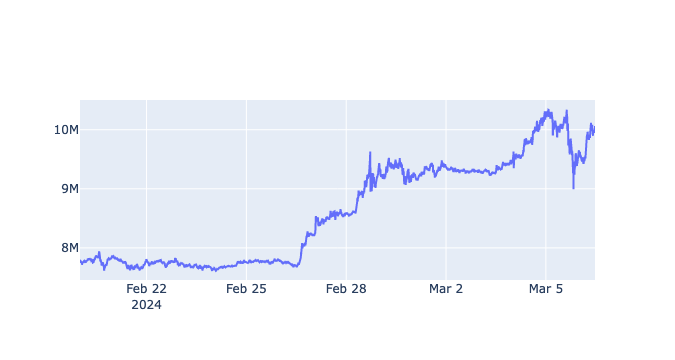

In [6]:
# Close

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["Close"], mode='lines', name='Close'))

# グラフの表示
fig.show()

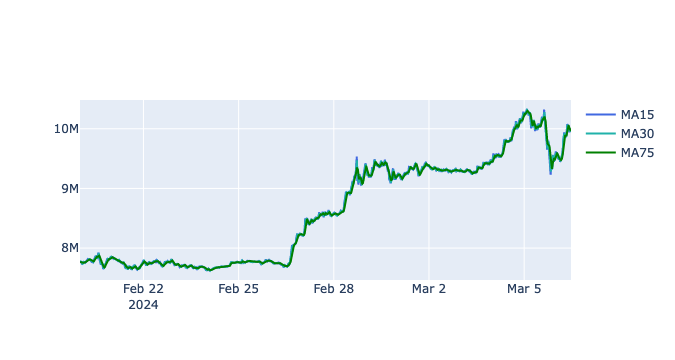

In [7]:
# 移動平均

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["ma15"], mode='lines', name='MA15', line=dict(color='royalblue')))

fig.add_trace(go.Scatter(x=df.index, y=df["ma30"], mode='lines', name='MA30', line=dict(color='lightseagreen')))

fig.add_trace(go.Scatter(x=df.index, y=df["ma75"], mode='lines', name='MA75', line=dict(color='green')))

# グラフの表示
fig.show()

In [8]:
df[df['dc'] != 0]

,Open,High,Low,Close,Volume,Dividends,Stock Splits,AD,ma15,ma30,...,dc,upper2,lower2,macd,macd_signal,hist,rsi14,rsi28,slowK,slowD
Datetime,,,,,,,,,,,,,,,,,,,,,
2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,1,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,1.521712e+01,47.191591
2024-02-20 02:32:00+00:00,7759100.5,7759100.5,7759100.5,7759100.5,0,0.0,0.0,-7.432920e+09,7.764717e+06,7.764812e+06,...,1,7.770650e+06,7.758769e+06,636.203231,1769.836864,-1133.633633,43.074807,49.468251,-9.473903e-15,7.524183
2024-02-20 03:20:00+00:00,7761689.5,7761689.5,7761689.5,7761689.5,0,0.0,0.0,-9.741622e+09,7.767669e+06,7.768152e+06,...,1,7.782322e+06,7.759331e+06,-887.796683,475.283094,-1363.079776,41.124724,47.310356,2.290161e+01,47.416899
2024-02-20 03:58:00+00:00,7754475.0,7755237.5,7754475.0,7755237.5,2124414976,0.0,0.0,-8.242158e+09,7.763264e+06,7.764008e+06,...,1,7.771498e+06,7.757406e+06,-1895.033509,-764.020153,-1131.013356,33.884220,41.798188,2.578671e+00,11.970668
2024-02-20 05:04:00+00:00,7783995.5,7783995.5,7783995.5,7783995.5,274989056,0.0,0.0,-1.529188e+08,7.784632e+06,7.784707e+06,...,1,7.788505e+06,7.781915e+06,1354.160941,2010.690578,-656.529637,53.146146,57.421009,4.839921e+01,59.001339
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-06 07:39:00+00:00,9872853.0,9872853.0,9872853.0,9872853.0,222298112,0.0,0.0,-2.278190e+12,9.882475e+06,9.882802e+06,...,1,9.919789e+06,9.855083e+06,-3158.067219,-124.588869,-3033.478350,46.689078,48.896872,6.598304e+01,64.230353
2024-03-06 08:44:00+00:00,10034718.0,10034718.0,10032841.0,10032841.0,2964324352,0.0,0.0,-2.226317e+12,1.006985e+07,1.006999e+07,...,1,1.012136e+07,1.002466e+07,3142.973604,15092.759542,-11949.785938,44.495419,52.300373,1.287489e+01,4.291632
2024-03-06 09:32:00+00:00,10014879.0,10014879.0,10014879.0,10014879.0,0,0.0,0.0,-2.221071e+12,1.005132e+07,1.005250e+07,...,1,1.008874e+07,1.002258e+07,-2948.608083,2431.808049,-5380.416132,38.534908,45.749837,1.647354e+00,9.530352


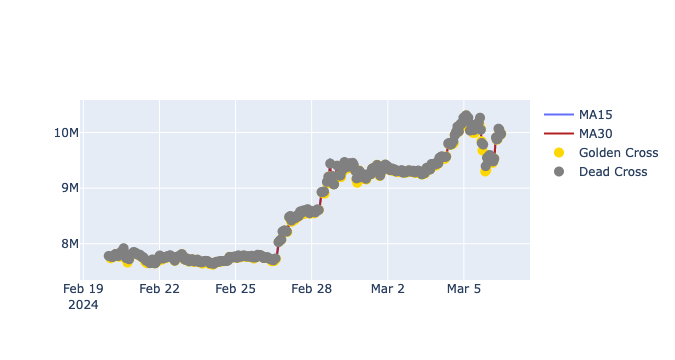

In [9]:
# ゴールデンクロス，デッドクロス

import plotly.graph_objects as go

# 移動平均線のグラフを作成
fig = go.Figure()

# MA15とMA30の線を追加
fig.add_trace(go.Scatter(x=df.index, y=df["ma15"], mode='lines', name='MA15'))
fig.add_trace(go.Scatter(x=df.index, y=df["ma30"], mode='lines', name='MA30', line=dict(color='firebrick')))

# ゴールデンクロスの点を追加（ゴールデンクロスの日にMA15の値をプロット）
gc_dates = df.index[df["gc"] == 1]
gc_values = df.loc[df["gc"] == 1, "ma15"]
fig.add_trace(go.Scatter(x=gc_dates, y=gc_values, mode='markers', name='Golden Cross', marker=dict(color='gold', size=10)))

# デッドクロスの点を追加（デッドクロスの日にMA15の値をプロット）
dc_dates = df.index[df["dc"] == 1]
dc_values = df.loc[df["dc"] == 1, "ma15"]
fig.add_trace(go.Scatter(x=dc_dates, y=dc_values, mode='markers', name='Dead Cross', marker=dict(color='gray', size=10)))

# グラフの表示
fig.show()


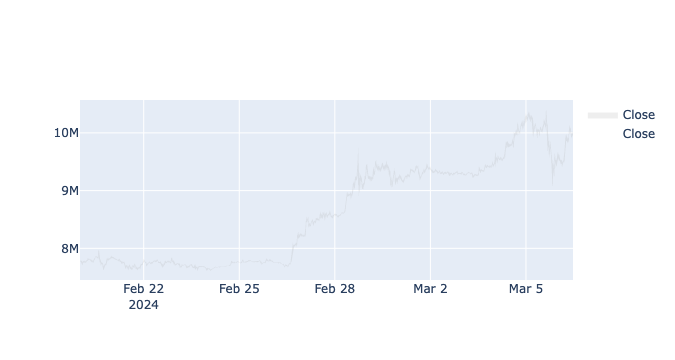

In [10]:
# ボリンジャーバンド曲線

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["upper2"], mode='lines', name='Close',line={'color':'lavender', 'width':0}))
fig.add_trace(go.Scatter(x=df.index, y=df["lower2"], mode='lines', name='Close', line={'color':'lavender', 'width':0},
                   fill='tonexty',fillcolor='rgba(170, 170, 170, .2)'))

# グラフの表示
fig.show()

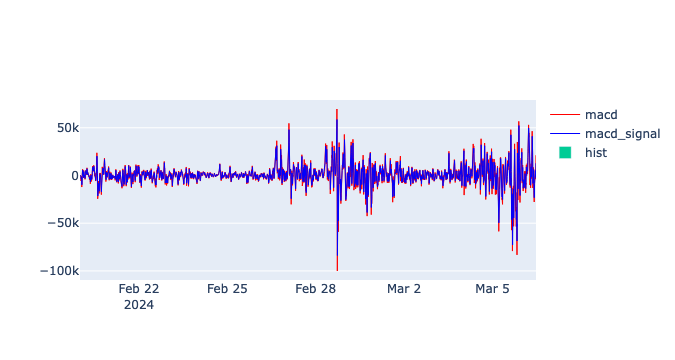

In [11]:
# MACD(マックディー)
# MACD（移動平均収束拡散手法）は短期の移動平均線と中長期の移動平均線を使用することで、買いと売りを判断する手法

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["macd"], mode='lines', name='macd',line={'color':'red', 'width':1}))
fig.add_trace(go.Scatter(x=df.index, y=df["macd_signal"], mode='lines', name='macd_signal',line={'color':'blue', 'width':1}))
fig.add_trace(go.Bar(x=df.index, y=df["hist"], name='hist'))

# グラフの表示
fig.show()

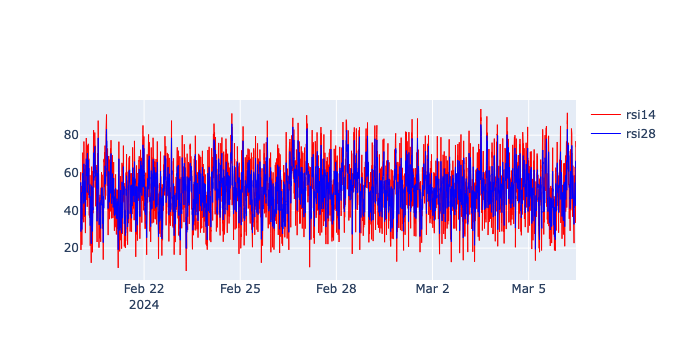

In [12]:
# RSI
# 

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["rsi14"], mode='lines', name='rsi14',line={'color':'red', 'width':1}))
fig.add_trace(go.Scatter(x=df.index, y=df["rsi28"], mode='lines', name='rsi28',line={'color':'blue', 'width':1}))

# グラフの表示
fig.show()

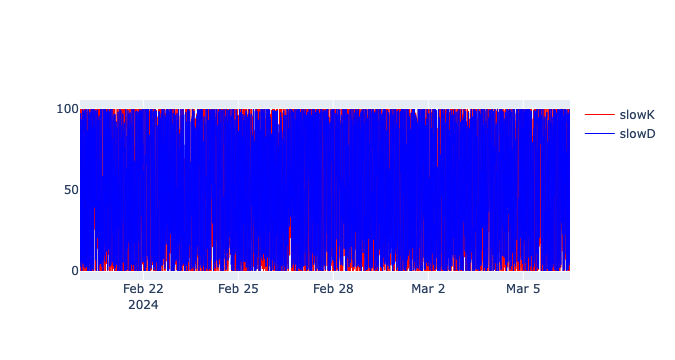

In [13]:
# ストキャスティクス
# 

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["slowK"], mode='lines', name='slowK',line={'color':'red', 'width':1}))
fig.add_trace(go.Scatter(x=df.index, y=df["slowD"], mode='lines', name='slowD',line={'color':'blue', 'width':1}))

# グラフの表示
fig.show()

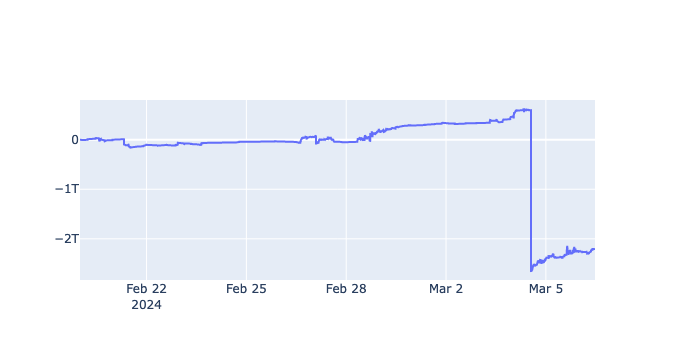

In [14]:
# Williams A/D
# 買いシグナル：逆行現象が発生している(価格が下落または横ばいで、Williams A/Dが上昇している場合)
# 売りシグナル：逆行現象が発生している(価格が上昇または横ばいで、Williams A/Dが下落している場合)

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=df.index, y=df["AD"], mode='lines', name='AD'))

# グラフの表示
fig.show()

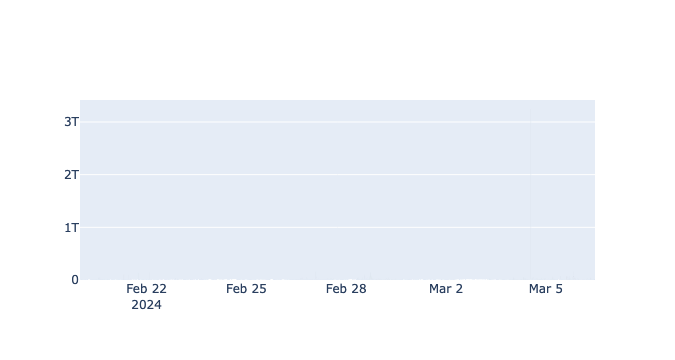

In [15]:
# Volume

import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Bar(x=df.index, y=df["Volume"], name='Volume', marker={'color':'black'}))

# グラフの表示
fig.show()

In [16]:
# 箱ひげ図
# 1分足だと値動きがあまりないので必要なし

# import plotly.graph_objects as go

# fig = go.Figure()

# fig.add_trace(go.Candlestick(
#                        x=df.index, #x軸の値
#                        open=df['Open'], #始値のシリーズ
#                        high=df['High'], #高値のシリーズ
#                        low=df['Low'], #安値のシリーズ
#                        close=df['Close'], #終値のシリーズ
#                        increasing_line_color = 'red', #陽線の緑の色
#                        increasing_line_width = 1.0, #陽線のヒゲの幅
#                        increasing_fillcolor = 'red', #陽線の実体の色
#                        decreasing_line_color = 'gray', #陰線の緑の色
#                        decreasing_line_width = 1.0, #陰線のヒゲの幅
#                        decreasing_fillcolor = 'gray'), #陰線の実体の色
#              )

# # グラフの表示
# fig.show()

In [19]:
df.to_csv('./data/BTC_1m_talib.csv', index=True)

In [18]:
df

,Open,High,Low,Close,Volume,Dividends,Stock Splits,AD,ma15,ma30,...,dc,upper2,lower2,macd,macd_signal,hist,rsi14,rsi28,slowK,slowD
Datetime,,,,,,,,,,,,,,,,,,,,,
2024-02-20 00:00:00+00:00,7780113.0,7780113.0,7780113.0,7780113.0,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,1,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:01:00+00:00,7780712.0,7780712.0,7780712.0,7780712.0,247201792,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:02:00+00:00,7778306.0,7778306.0,7777378.0,7777378.0,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:03:00+00:00,7780024.5,7780024.5,7780024.5,7780024.5,0,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
2024-02-20 00:04:00+00:00,7781959.5,7781959.5,7781959.5,7781959.5,383778816,0.0,0.0,0.000000e+00,7.781046e+06,7.780570e+06,...,0,7.785456e+06,7.775439e+06,192.623811,46.695871,145.927941,56.689785,53.592939,15.217124,47.191591
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-06 11:21:00+00:00,10038192.0,10038192.0,10038192.0,10038192.0,8564768768,0.0,0.0,-2.198357e+12,9.983745e+06,9.981591e+06,...,0,1.002708e+07,9.934943e+06,12008.756790,3933.697380,8075.059410,73.264285,63.642598,100.000000,91.694090
2024-03-06 11:22:00+00:00,10055488.0,10055488.0,10055488.0,10055488.0,19096666112,0.0,0.0,-2.198357e+12,9.988667e+06,9.983948e+06,...,0,1.003867e+07,9.930392e+06,15652.804391,6277.518782,9375.285609,76.848494,66.403850,100.000000,100.000000
2024-03-06 11:23:00+00:00,10055033.0,10055033.0,10055033.0,10055033.0,3436183552,0.0,0.0,-2.198357e+12,9.993653e+06,9.986179e+06,...,0,1.004831e+07,9.927624e+06,18293.151607,8680.645347,9612.506260,76.557730,66.266550,99.494090,99.831363
